In [1]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append('../coral')
sys.path.append('../')

import utils_HCC
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random 
import scipy
import seaborn as sns

from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from torch.utils.data import DataLoader, TensorDataset,ConcatDataset
from scipy.stats import zscore

from sklearn.neighbors import KDTree
from coral import coral_main, VisCoxDataset, utils, utils_exp, utils_simu
from scipy.spatial import cKDTree

import scanpy as sc
import anndata
import torch

import os

In [2]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

if torch.cuda.is_available():
    print("GPU is available.")
    gpu_count = torch.cuda.device_count()
    print(f"Number of GPUs available: {gpu_count}")
    for i in range(gpu_count):
        print(f"GPU {i}: {torch.cuda.get_device_name(i)}")
else:
    print("GPU is not available.")
    

GPU is available.
Number of GPUs available: 1
GPU 0: NVIDIA H100 80GB HBM3


In [3]:
codex_folder = '/hpc/mydata/siyu.he/Siyu_projects/HCC_project/codex_raw/'
visium_folder = '/hpc/mydata/siyu.he/Siyu_projects/HCC_project/visium/'

codex_seg_folder = '/hpc/mydata/siyu.he/Siyu_projects/HCC_project/codex_seg/'
trans_loc_folder = '/hpc/mydata/siyu.he/Siyu_projects/HCC_project/transformed_visium_loc'
cell_type_folder = '/hpc/mydata/siyu.he/Siyu_projects/HCC_project/codex_cell_type/'

meta_info =[            
            ['73_3_pre', 'FinalLiv-27_c001_v001_r001_reg014_he_aligned.tif', '073-3.ome.tif','cytassist_73_pre', 'FinalLiv-27_c001_v001_r001_reg014_codex.csv','073_3_tissue_positions_list.csv','FinalLiv-27_c001_v001_r001_reg014.cell_types.csv'],
            ['73_5_post','FinalLiv-27_c001_v001_r001_reg016_he_aligned.tif', '073-5.ome.tif','cytassist_73_post','FinalLiv-27_c001_v001_r001_reg016_codex.csv','073_5_tissue_positions_list.csv','FinalLiv-27_c001_v001_r001_reg016.cell_types.csv'],
            ['84_2_pre', 'FinalLiv-27_c002_v001_r001_reg009_he_aligned.tif', '084-2.ome.tif','cytassist_84_pre', 'FinalLiv-27_c002_v001_r001_reg009_codex.csv','084_2_tissue_positions_list.csv','FinalLiv-27_c002_v001_r001_reg009.cell_types.csv'],
            ['84_3_post','FinalLiv-27_c002_v001_r001_reg010_he_aligned.tif', '084-3.ome.tif','cytassist_84_post','FinalLiv-27_c002_v001_r001_reg010_codex.csv','084_3_tissue_positions_list.csv','FinalLiv-27_c002_v001_r001_reg010.cell_types.csv'],
           ]
meta_info = pd.DataFrame(meta_info, columns=['sample','histo_file','codex_raw_file','visium_file','codex_seg_file','trans_loc_file','cell_type_file'])

cell_type_label_mapping = {'Neutrophils': 0,
 'Macrophages': 1,
 'B cells': 2,
 'CD4 T cells': 3,
 'Stroma Uncharacterized': 4,
 'INFg+': 5,
 'Macrophages M2-like': 6,
 'Fibroblasts': 7,
 'Endothelial cells': 8,
 'Tumor Inos': 9,
 'Tumor': 10,
 'CD8 T cells': 11,
 'Dendritic cells': 12,
 'Unknown': 13}

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


1046
View of AnnData object with n_obs × n_vars = 777 × 18074
    obs: 'barcode', 'in_tissue', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres', 'transformed coords x', 'transformed coords y'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'
(777, 1046)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:767: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)
/tmp/ipykernel_444526/4047234546.py:22: ImplicitModificationWarning: Setting element `.obsm['spatial']` of view, initializing view as actual.
  visium_adata_temp.obsm['spatial'] =np.concatenate([visium_adata_temp.obs['transformed coords x'].values[:,None],visium_adata_temp.obs['transformed coords y'].values[:,None]],axis=1)
/tmp/ipykernel_444526/4047234546.py:23: ImplicitModificationWarning: Setting element `.obsm['spatial']` of view, init

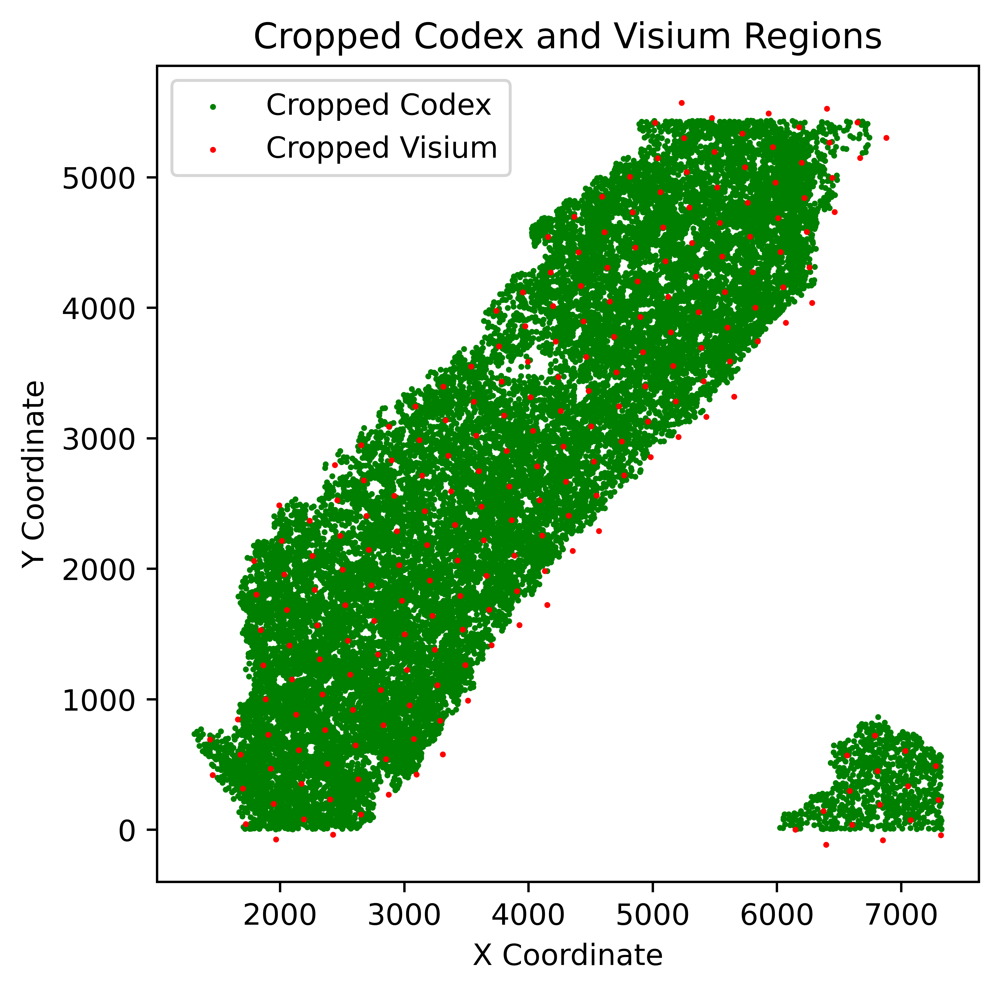

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/torch_geometric/deprecation.py:22: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


Epoch 0, Loss: 2437725.6850804426
Epoch 1, Loss: 2276293.073969331
Epoch 2, Loss: 2242889.887443439
Epoch 3, Loss: 2226268.0478255404
Epoch 4, Loss: 2202457.532554047
Epoch 5, Loss: 2191790.111488185
Epoch 6, Loss: 2188018.051721971
Epoch 7, Loss: 2178382.489253394
Epoch 8, Loss: 2181359.1615133234
Epoch 9, Loss: 2156084.121292107
Epoch 10, Loss: 2152034.783496732
Epoch 11, Loss: 2145088.4710281547
Epoch 12, Loss: 2126067.67615636
Epoch 13, Loss: 2128120.267282554
Epoch 14, Loss: 2125796.920563097
Epoch 15, Loss: 2108501.8717320263
Epoch 16, Loss: 2101619.6902337857
Epoch 17, Loss: 2091965.33107089
Epoch 18, Loss: 2086659.5849673203
Epoch 19, Loss: 2086855.472285068
Epoch 20, Loss: 2078931.104638009
Epoch 21, Loss: 2072876.204248366
Epoch 22, Loss: 2063811.1258169934
Epoch 25, Loss: 2037301.4453242836
Epoch 26, Loss: 2035238.9822775263
Epoch 27, Loss: 2036203.580882353
Epoch 28, Loss: 2023142.223856209
Epoch 29, Loss: 2026265.6810583207
Epoch 30, Loss: 2020163.0290975363
Epoch 31, Loss

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


1046
View of AnnData object with n_obs × n_vars = 3427 × 18074
    obs: 'barcode', 'in_tissue', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres', 'transformed coords x', 'transformed coords y'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'
(3427, 1046)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:767: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)
/tmp/ipykernel_444526/4047234546.py:22: ImplicitModificationWarning: Setting element `.obsm['spatial']` of view, initializing view as actual.
  visium_adata_temp.obsm['spatial'] =np.concatenate([visium_adata_temp.obs['transformed coords x'].values[:,None],visium_adata_temp.obs['transformed coords y'].values[:,None]],axis=1)
/tmp/ipykernel_444526/4047234546.py:23: ImplicitModificationWarning: Setting element `.obsm['spatial']` of view, init

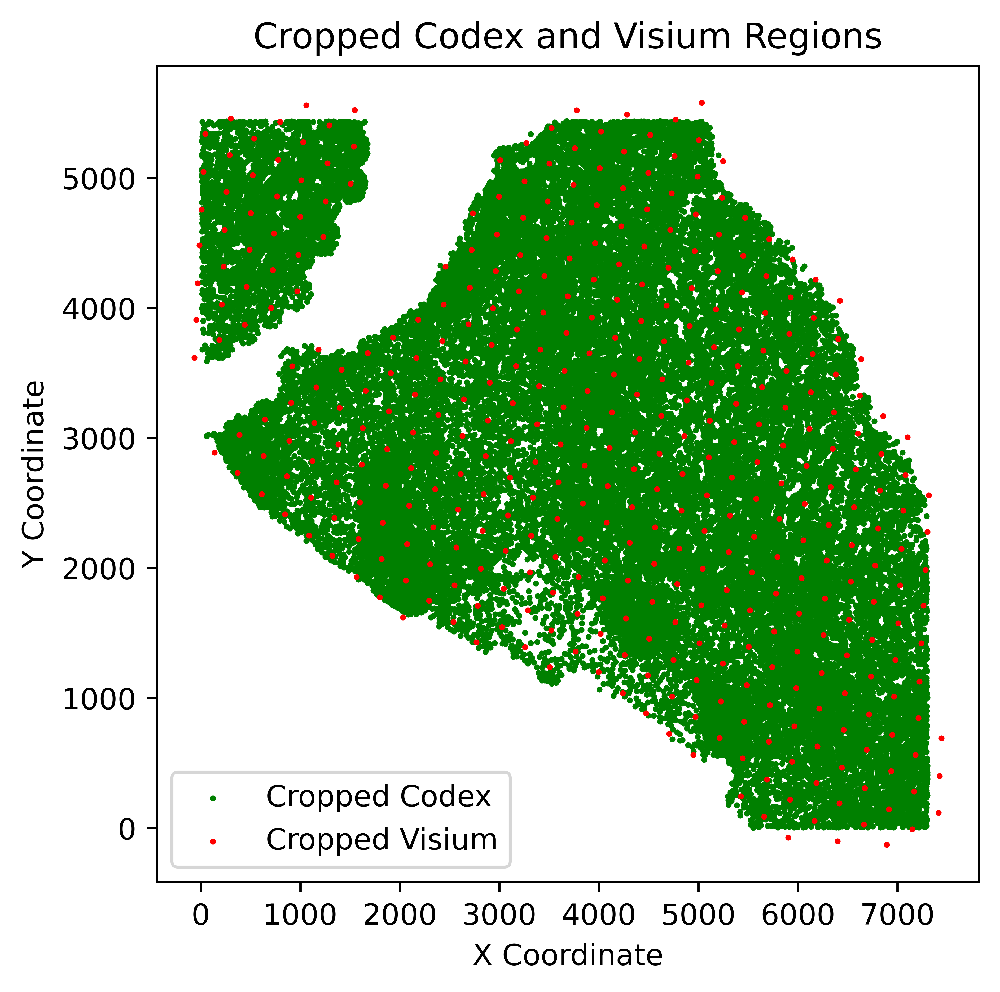

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/torch_geometric/deprecation.py:22: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


Epoch 0, Loss: 1313037.534180841
Epoch 1, Loss: 1227832.6082713206
Epoch 2, Loss: 1189066.5222655328
Epoch 3, Loss: 1165975.7972773446
Epoch 4, Loss: 1143355.0113542406
Epoch 5, Loss: 1118222.2707742737
Epoch 6, Loss: 1097072.3763436098
Epoch 7, Loss: 1073437.5812514764
Epoch 8, Loss: 1061353.755359674
Epoch 9, Loss: 1053986.615565202
Epoch 10, Loss: 1042482.5341365462
Epoch 11, Loss: 1033764.2743326246
Epoch 12, Loss: 1026590.5687898654
Epoch 13, Loss: 1020783.510453579
Epoch 14, Loss: 1016731.9825035436
Epoch 15, Loss: 1006815.8899273565
Epoch 16, Loss: 1003268.2893338058
Epoch 17, Loss: 995844.6586640681
Epoch 18, Loss: 990876.005861682
Epoch 19, Loss: 985803.6037237184
Epoch 20, Loss: 980433.3136664304
Epoch 21, Loss: 974523.4791371368
Epoch 22, Loss: 971511.9072909284
Epoch 23, Loss: 967498.3908723128
Epoch 24, Loss: 962077.9848511694
Epoch 25, Loss: 957565.6785229152
Epoch 26, Loss: 954292.1957683676
Epoch 27, Loss: 951650.1742410819
Epoch 28, Loss: 947450.9810270494
Epoch 29, Lo

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


1046
View of AnnData object with n_obs × n_vars = 1155 × 18074
    obs: 'barcode', 'in_tissue', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres', 'transformed coords x', 'transformed coords y'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'
(1155, 1046)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:767: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)
/tmp/ipykernel_444526/4047234546.py:22: ImplicitModificationWarning: Setting element `.obsm['spatial']` of view, initializing view as actual.
  visium_adata_temp.obsm['spatial'] =np.concatenate([visium_adata_temp.obs['transformed coords x'].values[:,None],visium_adata_temp.obs['transformed coords y'].values[:,None]],axis=1)
/tmp/ipykernel_444526/4047234546.py:23: ImplicitModificationWarning: Setting element `.obsm['spatial']` of view, init

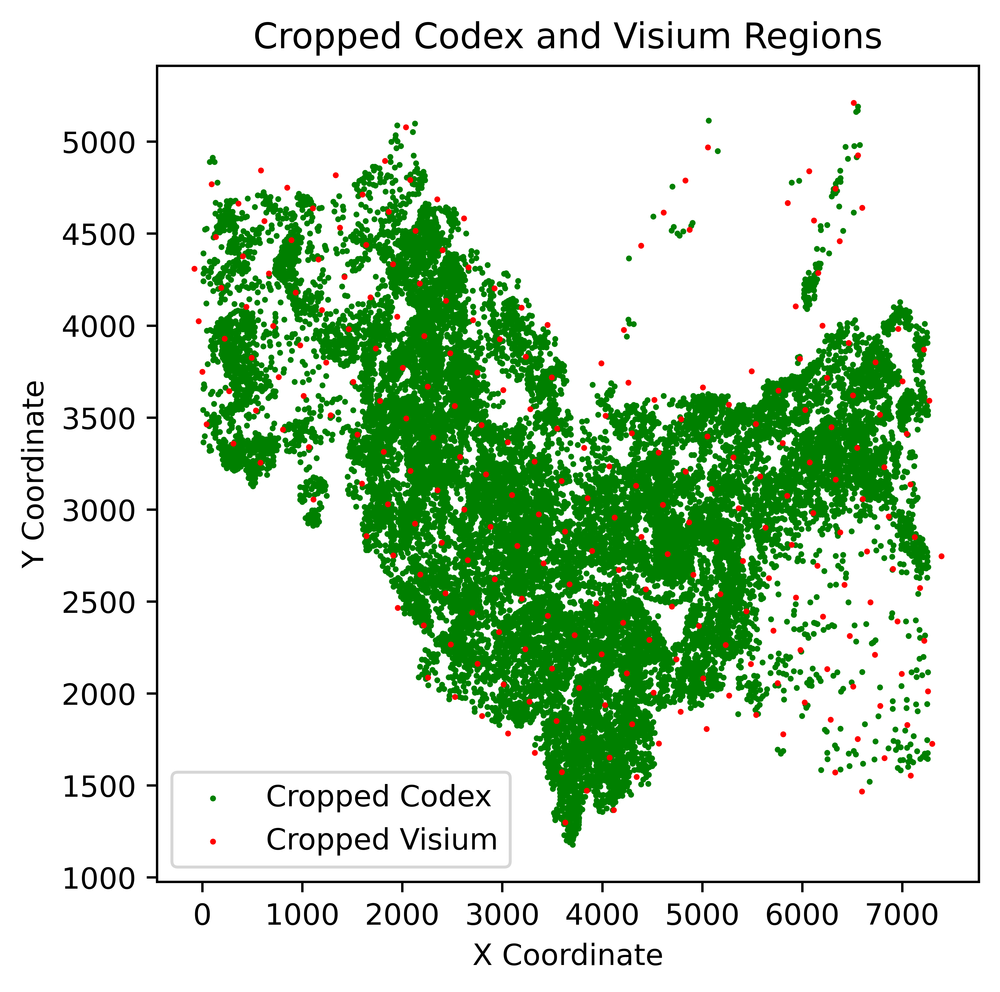

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/torch_geometric/deprecation.py:22: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


Epoch 0, Loss: 1267020.745166367
Epoch 1, Loss: 1134878.4939298562
Epoch 2, Loss: 1096936.3208558154
Epoch 3, Loss: 1077602.2540467626
Epoch 4, Loss: 1068674.4488534173
Epoch 5, Loss: 1060721.4121702637
Epoch 6, Loss: 1057316.6004946043
Epoch 7, Loss: 1053198.0342476019
Epoch 8, Loss: 1044797.0882419065
Epoch 9, Loss: 1040131.1504046762
Epoch 10, Loss: 1037772.948478717
Epoch 11, Loss: 1035771.9454436451
Epoch 12, Loss: 1030540.4727218226
Epoch 13, Loss: 1026671.5376948441
Epoch 14, Loss: 1021211.4028402278
Epoch 15, Loss: 1017368.5481489808
Epoch 16, Loss: 1008190.942146283
Epoch 17, Loss: 1005609.6831160072
Epoch 18, Loss: 1001361.2902802757
Epoch 19, Loss: 995370.8835806355
Epoch 20, Loss: 989141.0167491008
Epoch 21, Loss: 981600.9130695444
Epoch 22, Loss: 976880.6330185852
Epoch 23, Loss: 969191.2165017986
Epoch 24, Loss: 966023.3348321343
Epoch 25, Loss: 959536.9521507794
Epoch 26, Loss: 954067.3692670864
Epoch 31, Loss: 930886.54676259
Epoch 32, Loss: 929992.2106564748
Epoch 33, 

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


1046
View of AnnData object with n_obs × n_vars = 3089 × 18074
    obs: 'barcode', 'in_tissue', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres', 'transformed coords x', 'transformed coords y'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'
(3089, 1046)


/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/aligned_df.py:67: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/anndata/_core/anndata.py:767: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)
/tmp/ipykernel_444526/4047234546.py:22: ImplicitModificationWarning: Setting element `.obsm['spatial']` of view, initializing view as actual.
  visium_adata_temp.obsm['spatial'] =np.concatenate([visium_adata_temp.obs['transformed coords x'].values[:,None],visium_adata_temp.obs['transformed coords y'].values[:,None]],axis=1)
/tmp/ipykernel_444526/4047234546.py:23: ImplicitModificationWarning: Setting element `.obsm['spatial']` of view, init

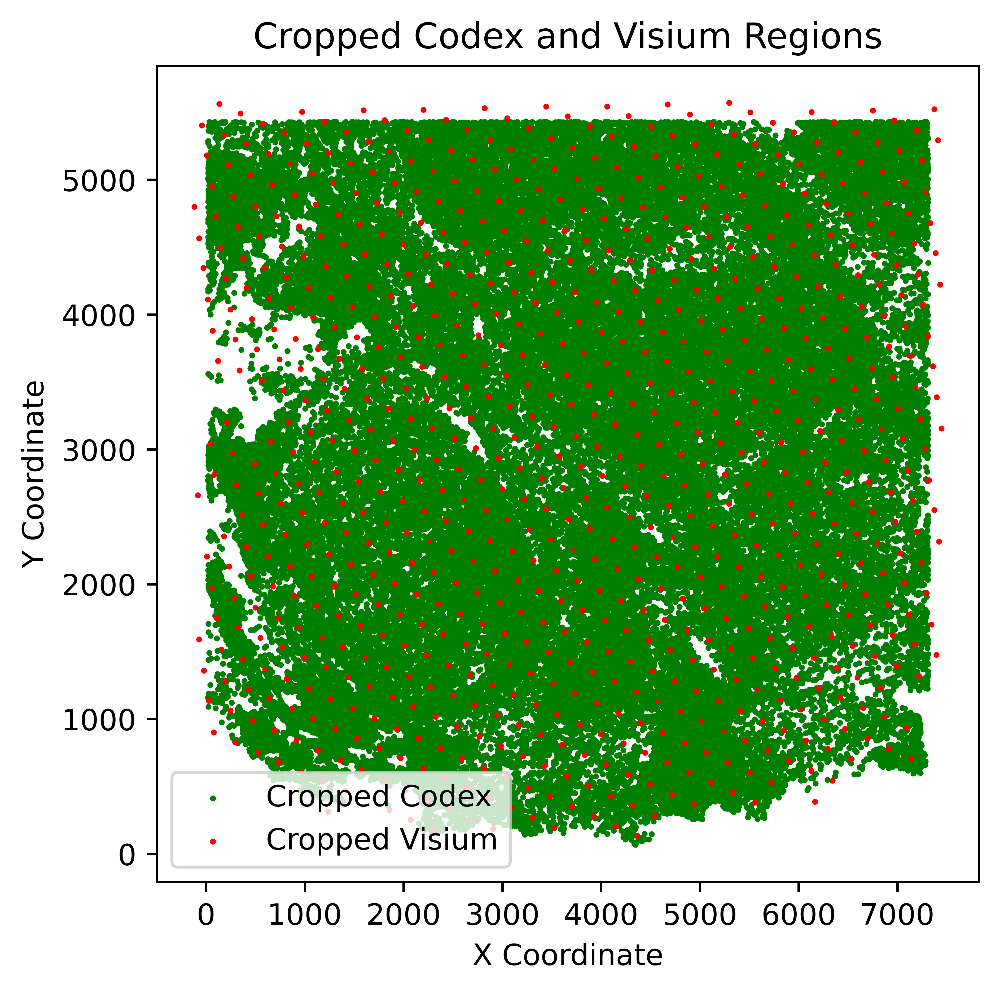

/hpc/mydata/siyu.he/anaconda/2023.03/x86_64/envs/scvi_v1_env/lib/python3.9/site-packages/torch_geometric/deprecation.py:22: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


Epoch 0, Loss: 1915435.9586599367
Epoch 1, Loss: 1739653.7267616785
Epoch 2, Loss: 1716698.0074821853
Epoch 3, Loss: 1701522.4805720507
Epoch 4, Loss: 1708813.194804038
Epoch 5, Loss: 1689737.354770388
Epoch 6, Loss: 1686338.0710213776
Epoch 7, Loss: 1666026.2875
Epoch 8, Loss: 1665437.5037212984
Epoch 9, Loss: 1644239.0221595408
Epoch 10, Loss: 1652205.2138657956
Epoch 11, Loss: 1640167.6010688837
Epoch 12, Loss: 1631266.877810768
Epoch 13, Loss: 1633057.8786124308
Epoch 14, Loss: 1628739.844794141
Epoch 15, Loss: 1621671.7381136185
Epoch 16, Loss: 1617533.4309778307
Epoch 17, Loss: 1618901.8154097388
Epoch 18, Loss: 1618230.043685669
Epoch 19, Loss: 1616949.8730997625


In [ ]:
for i in range(0,len(meta_info)
              ):
    visium_coords = []
    codex_coords = []
    histo_patches = []
    codex_patches = []
    visium_vectors = []
    codex_vectors = []
    sample_idx = []
    #histo_image = imread(os.path.join(histo_folder, meta_info.loc[i,'histo_file']))
    #codex_image = imread(os.path.join(codex_folder, meta_info.loc[i,'codex_raw_file']))
    #codex_image = codex_image.transpose(1, 2, 0)

    visium_adata_temp, codex_adata_temp = load_data(visium_path = os.path.join(visium_folder, meta_info.loc[i,'visium_file']),
                                                    trans_loc = os.path.join(trans_loc_folder, meta_info.loc[i,'trans_loc_file']),
                                                    codex_path = os.path.join(codex_seg_folder, meta_info.loc[i,'codex_seg_file']),
                                                    type_path = os.path.join(cell_type_folder, meta_info.loc[i,'cell_type_file']), 
                                                    cell_type_label_mapping = cell_type_label_mapping,
                                                    select_gene = select_gene

                                         )
    visium_adata_temp.obsm['spatial'] =np.concatenate([visium_adata_temp.obs['transformed coords x'].values[:,None],visium_adata_temp.obs['transformed coords y'].values[:,None]],axis=1)
    codex_adata_temp.obsm['spatial'] =np.concatenate([codex_adata_temp.obs.x.values[:,None],codex_adata_temp.obs.y.values[:,None]],axis=1)
    
    
    
    from sklearn.neighbors import NearestNeighbors

   
    overlap_distance_threshold = 150  # Adjust this based on your dataset's spatial scale

    # Get the spatial coordinates for both Codex and Visium datasets
    codex_coords = codex_adata_temp.obsm['spatial']
    visium_coords = visium_adata_temp.obsm['spatial']

    # Find Codex points near Visium points
    visium_nn = NearestNeighbors(n_neighbors=1).fit(visium_coords)
    distances, _ = visium_nn.kneighbors(codex_coords)
    codex_enlarged_mask = distances[:, 0] < overlap_distance_threshold
    codex_enlarged_coords = codex_coords[codex_enlarged_mask]

    # Find Visium points near Codex points
    codex_nn = NearestNeighbors(n_neighbors=1).fit(codex_coords)
    visium_to_codex_distances, _ = codex_nn.kneighbors(visium_coords)
    visium_cropped_mask = visium_to_codex_distances[:, 0] < overlap_distance_threshold
    visium_cropped_coords = visium_coords[visium_cropped_mask]

    # Crop the AnnData objects based on the masks
    codex_adata_cropped = codex_adata_temp[codex_enlarged_mask, :].copy()
    visium_adata_cropped = visium_adata_temp[visium_cropped_mask, :].copy()

    # Plot the cropped Codex and Visium regions
    fig, ax = plt.subplots(1, 1, figsize=(5, 5), dpi=800)

    # Plot cropped Codex points in green
    plt.scatter(codex_enlarged_coords[:, 0], codex_enlarged_coords[:, 1], s=1, color='g', label='Cropped Codex')

    # Plot cropped Visium points in red
    plt.scatter(visium_cropped_coords[:, 0], visium_cropped_coords[:, 1], s=1, color='r', label='Cropped Visium')

    # Add legend and labels
    plt.legend()
    plt.xlabel("X Coordinate")
    plt.ylabel("Y Coordinate")
    plt.title("Cropped Codex and Visium Regions")

    plt.show()
    
    
    codex_adata_cropped.obs['cell_type'] = codex_adata_cropped.obs['CELL_TYPE']
    visium_adata_cropped.X = visium_adata_cropped.X.toarray()
    combined_expr, codex_coords, one_hot_cell_types, spot_indices, visium_expr = utils.preprocess_data(visium_adata_cropped, codex_adata_cropped)

    dataloader = utils.prepare_local_subgraphs(combined_expr, codex_coords, one_hot_cell_types, 
                                               spot_indices, visium_expr,n_neighbors=200)    
    
    
    model, optimizer = coral_main.create_model(visium_dim = visium_adata_cropped.shape[1],
                                               codex_dim = codex_adata_cropped.shape[1],
                                               cell_type_dim=one_hot_cell_types.shape[1],

                                               latent_dim=32, 
                                               hidden_channels=128, 
                                               v_dim = 1
                                              )
    model.to(device)

    
    coral_main.train_model(model, optimizer, dataloader, epochs = 60,device = device)



    # Define the path where you want to save the model
    model_save_path = "model_" + str(i)+".pth"
    optimizer_save_path = "optimizer_"+ str(i)+".pth"

    # Save the model's state_dict
    torch.save(model.state_dict(), model_save_path)
    # Save the optimizer's state_dict
    torch.save(optimizer.state_dict(), optimizer_save_path)

    (generated_expr, 
     generated_protein,latent_rep, 
     locations,
     visium_true,
     codex_true, 
     attn_weights_all, 
     edges_all,
     v_values, 
     cell_types)= coral_main.generate_and_validate(model, dataloader,device) 

    adata_model_gener = anndata.AnnData(generated_protein)
    adata_model_gener.obsm['generated_expr'] = generated_expr
    adata_model_gener.obsm['coral'] = latent_rep
    adata_model_gener.obsm['spatial'] = locations
    adata_model_gener.obsm['visium_true'] = visium_true
    adata_model_gener.obsm['codex_true'] = codex_true
    #adata_model_gener.obsm['attn_weights_all'] = attn_weights_all
    adata_model_gener.obsm['v_values'] = v_values
    adata_model_gener.obsm['cell_types'] = cell_types
    adata_model_gener_reindexed = reindex_adata_qz(codex_adata_cropped, adata_model_gener)
#
    adata_model_gener_reindexed.write('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/hcc_results/data_test_'+str(i)+'.h5ad')
    np.save('/hpc/mydata/siyu.he/Siyu_projects/coral_storage/coral_results/hcc_results/'+'attn_weights_all_test'+str(i)+'.npy',attn_weights_all)


9
3
0
1
2
5
4
12
7
6
13
11
10


(-281.40000000000003, 6019.4, -260.3, 5554.3)

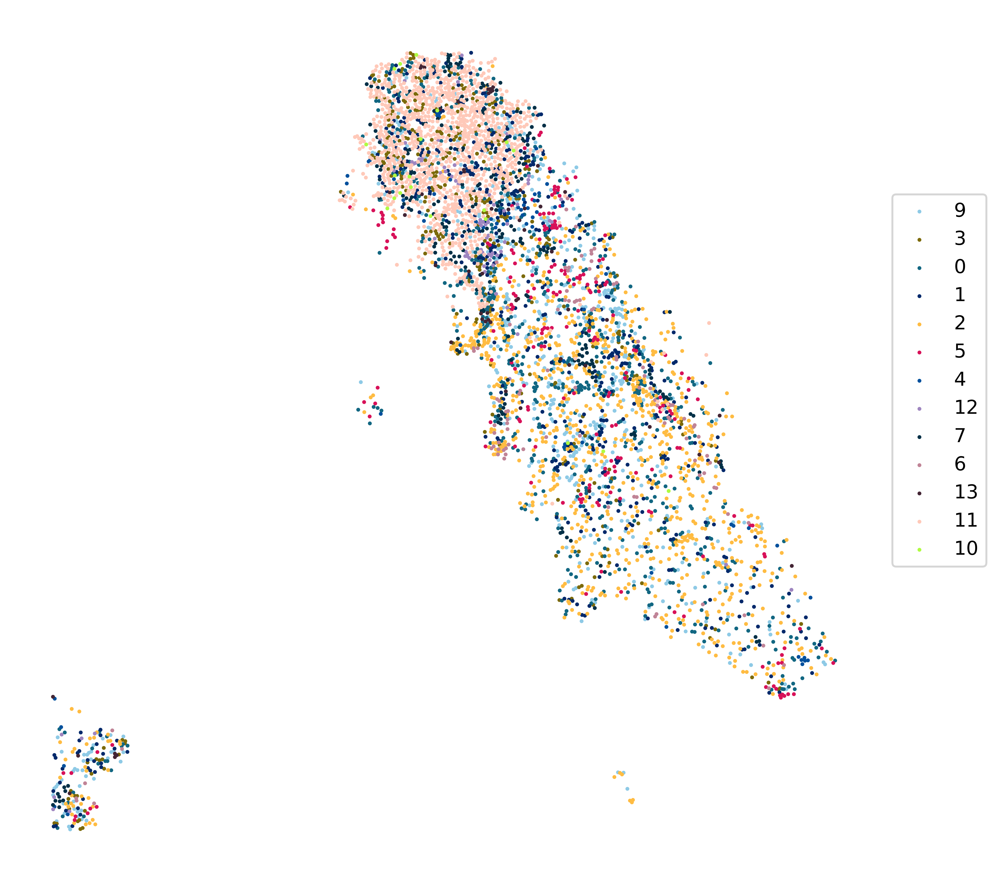

In [14]:
color_list = [
'#8ecae6', #4 , #1  219ebc
'#7c6a0a',#14
'#126782',#15
    
'#00296b', #16                                                   
'#ffbc42', #2  
'#d81159',
    
'#00509d',#5
   
'#9f86c0',#6 
'#023047',#7
'#c08497',#8
'#432534', #9
'#ffc9b9',  #10  
'#affc41', #11 
'k',#12 
'y',#13 
'g'#14 
]
fig, ax = plt.subplots(1,1,figsize=(8,8),dpi=800)
for j,i in enumerate(codex_adata_cropped.obs['CELL_TYPE'].unique()):
    print(i)
    plt.scatter(codex_adata_cropped.obsm['spatial'][codex_adata_cropped.obs['CELL_TYPE']==i,0],
                codex_adata_cropped.obsm['spatial'][codex_adata_cropped.obs['CELL_TYPE']==i,1],
                s=1,
                color = color_list[j]
               )
plt.legend(codex_adata_cropped.obs['CELL_TYPE'].unique(),bbox_to_anchor=(1.01,0.8))
plt.axis('off') 
#plt.gca().invert_yaxis()

0
2
5
1
8
6
3
7
10
9
4
11


/hpc/mydata/siyu.he/Siyu_projects/Coral_project/fig2_simulation/../coral/utils_simu.py:214: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_, resolution=res,random_state=42)


AnnData object with n_obs × n_vars = 107 × 1046
    obs: 'barcode', 'in_tissue', 'array_row', 'array_col', 'pxl_row_in_fullres', 'pxl_col_in_fullres', 'transformed coords x', 'transformed coords y', 'leiden', 'cluster'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial', 'log1p', 'pca', 'neighbors', 'leiden'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

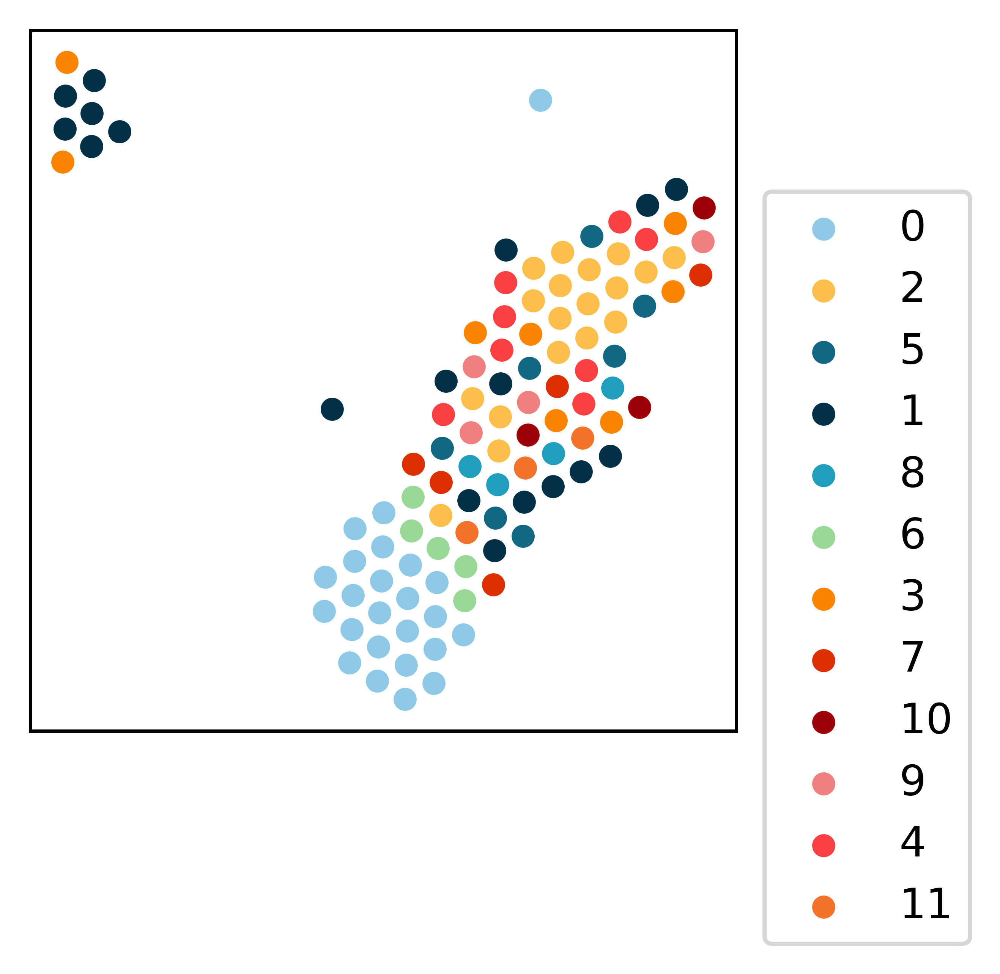

In [15]:
utils_simu.plot_pca_cluster(visium_adata_cropped,
                               res=2,
                               size =20,
                               color_list = [
'#8ecae6',
'#fcbf49',
'#126782',
'#023047',
'#219ebc',                                   
'#98d998',

'#fb8500',
'#dc2f02',
                                   
'#9d0208',
'#f08080',
'#f94144',
'#f3722c',
'#f8961e',
'#f9c74f',
'#90be6d',
'#43aa8b',
'#577590',  
'#226CE0',
'#534B62'
],
                            figsize=(3,3),
                            legd = True,
                            return_ = True,
                              )

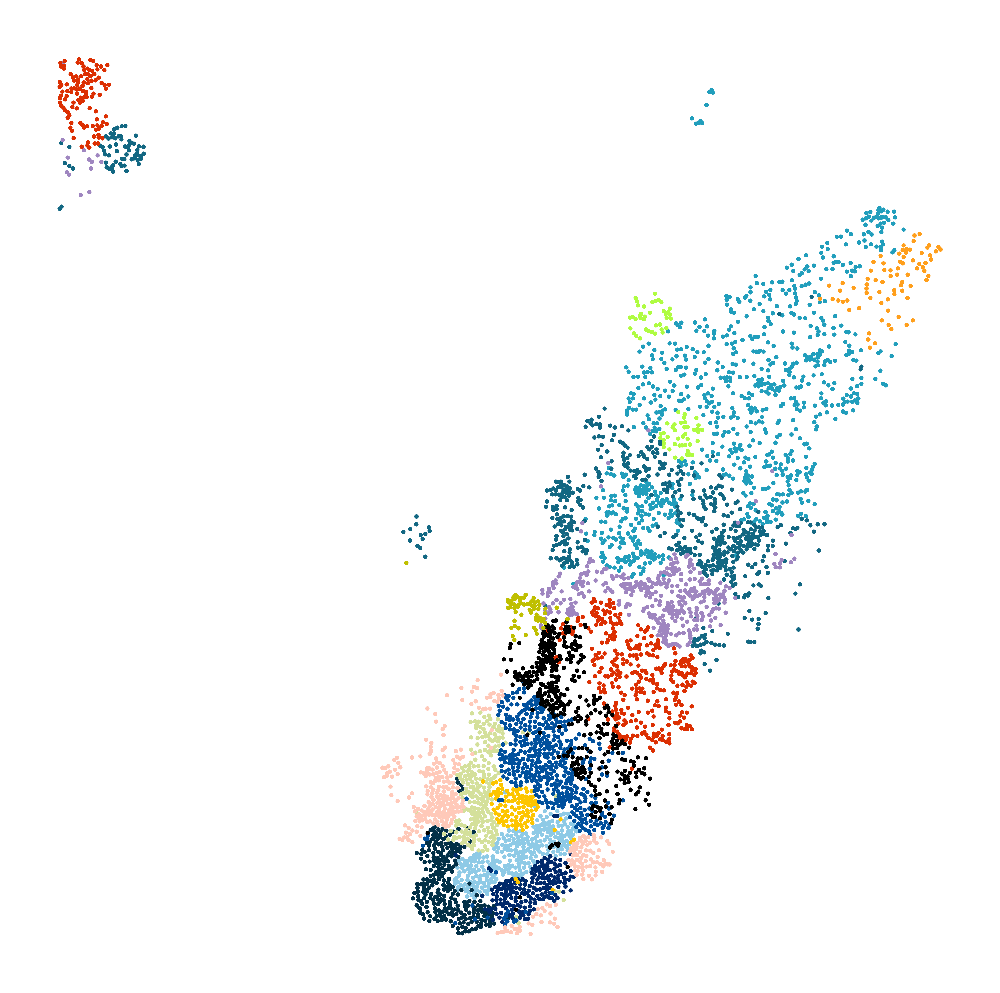

In [16]:
adata_cluster = utils_simu.plot_latent_cluster(adata_model_gener,
                               res  = 0.5,
                               size =1,
color_list = [
'#8ecae6',
'#219ebc',
'#126782',
'#9f86c0',              
'#023047',                     
'#d4e09b',
'#ff9f1c',
'#dc2f02',
'#00296b',                                                   

'#fdc500',
'#00509d',  
'#ffc9b9',   
'#affc41', 
'k',
    'y',
    'g',
    '#fdc500',
'#00509d',  
'#ffc9b9',   
'#affc41', 
'k',
    'y',
    'g'
],
                               figsize=(8,8),                
                               use_rep = 'coral',
                               #legd = True,
                               return_ = True,
                              )

0
1
10
11
12
13
14
2
3
4
5
6
7
8
9


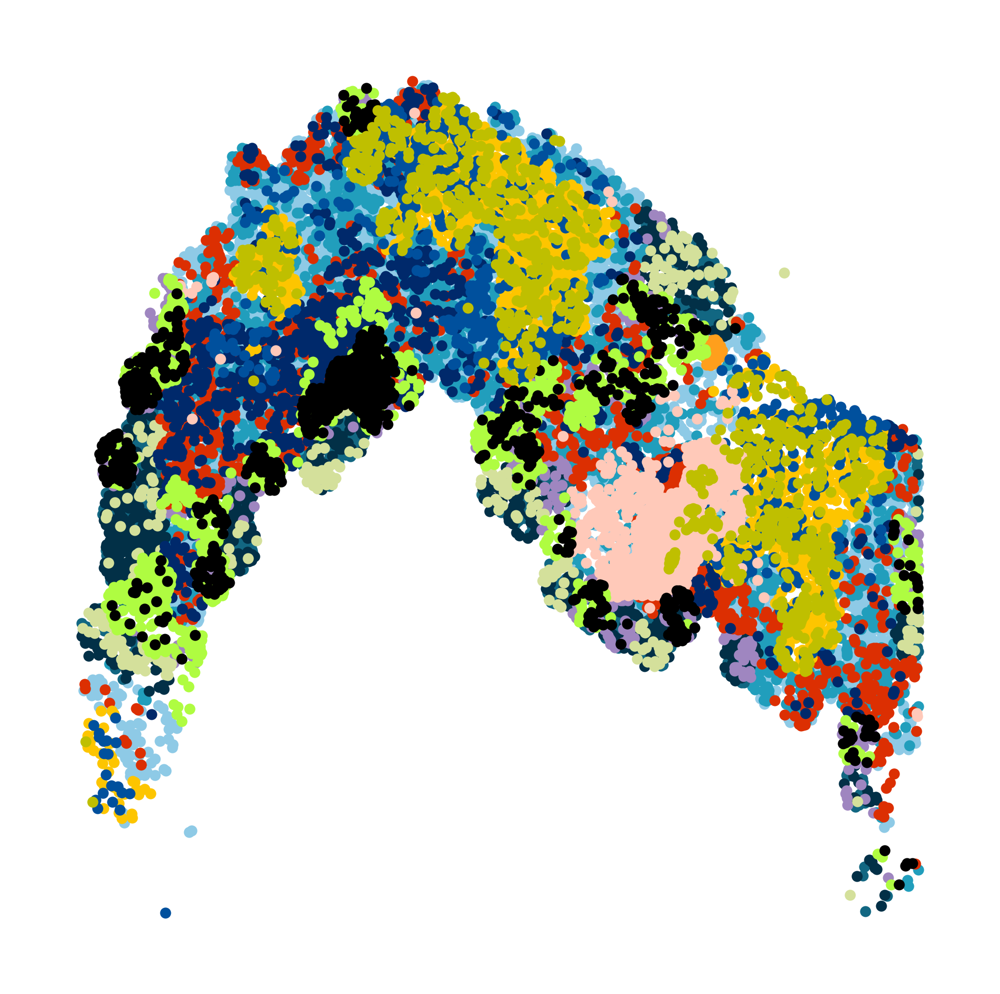

In [111]:
color_list = [
'#8ecae6',
'#219ebc',
'#126782',
'#023047',
'#9f86c0',                                   
'#d4e09b',
'#ff9f1c',
'#dc2f02',
'#00296b',                                                   

'#fdc500',
'#00509d',  
'#ffc9b9',   
'#affc41', 
'k',
    'y',
    'g',
    '#fdc500',
'#00509d',  
'#ffc9b9',   
'#affc41', 
'k',
    'y',
    'g'
]
fig, ax = plt.subplots(1,1,figsize=(3,3),dpi=800)
for j,i in enumerate(sorted(adata_cluster.obs['cluster'].unique())):
    print(i)
    plt.scatter(adata_cluster.obsm['spatial'][adata_cluster.obs['cluster']==i,0],
                adata_cluster.obsm['spatial'][adata_cluster.obs['cluster']==i,1],
                s=1,
                color = color_list[j]
               )
#plt.legend(sorted(adata_cluster.obs['cluster'].unique()),bbox_to_anchor=(1.01,0.8))
plt.axis('off') 
plt.gca().invert_yaxis()

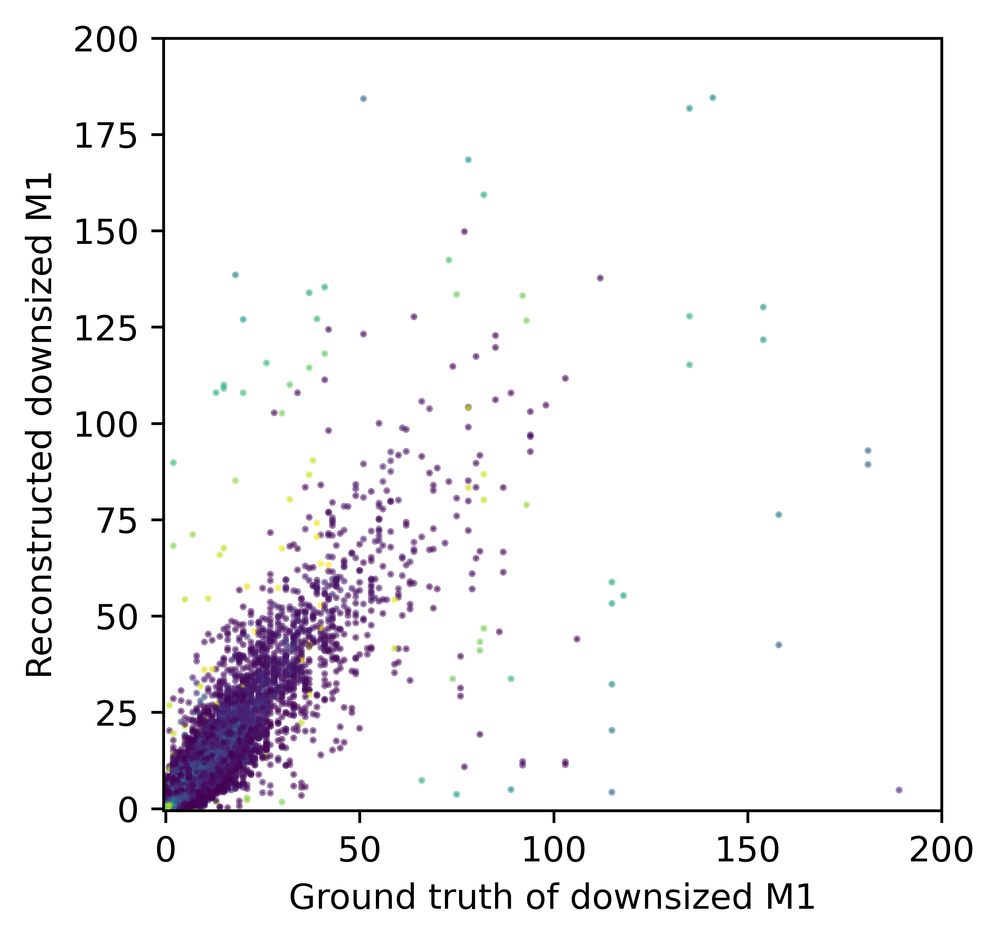

In [114]:
generated_adata = anndata.AnnData(generated_expr)
generated_adata.obsm['latent_rep'] = latent_rep
generated_adata.obsm['spatial'] = locations

utils.display_reconst(
                pd.DataFrame((np.array(visium_true))),
                pd.DataFrame((np.array(generated_expr))),
                density=True,
                x_label='Ground truth of downsized M1',
                y_label='Reconstructed downsized M1',
                size=(4,4),
                min_val=-0.5,
                max_val=200,
               )

Text(0, 0.5, 'Predicted high-res RNA')

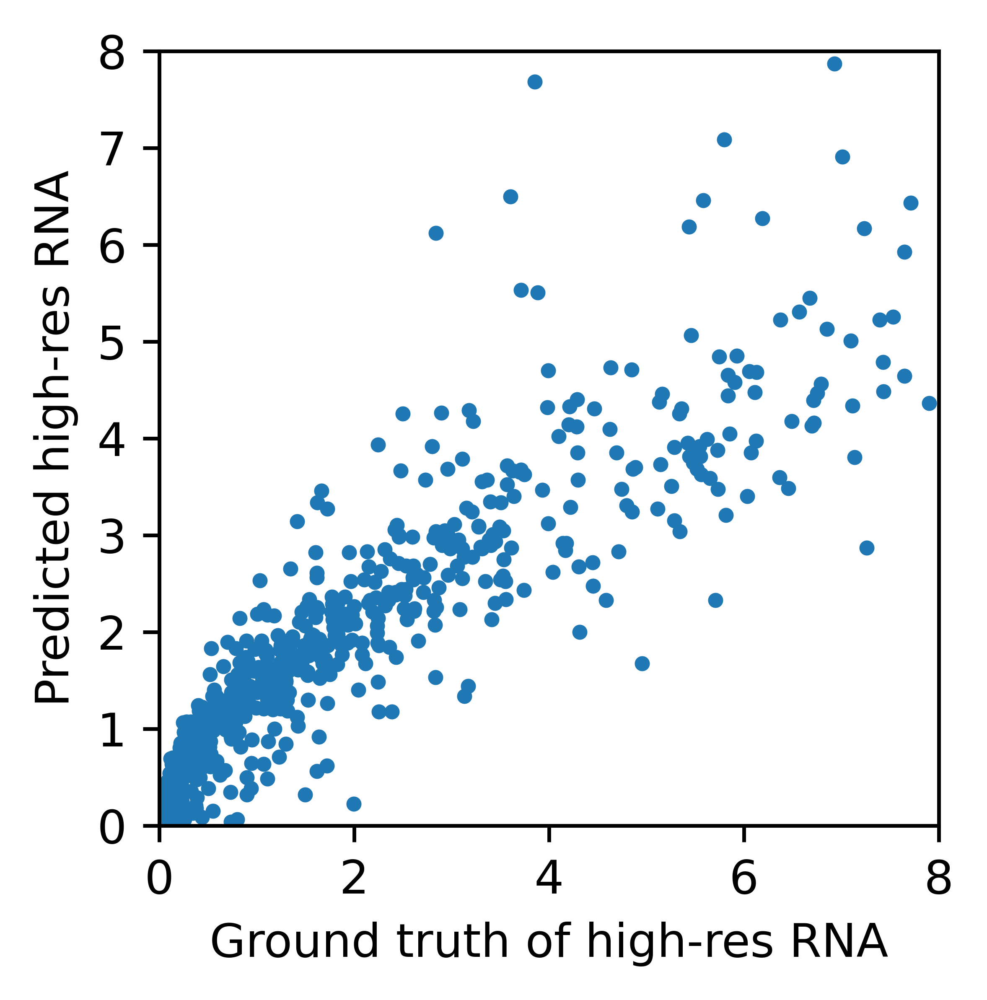

In [62]:
plt.subplots(1,1,figsize=(3,3),dpi=800)
plt.scatter(generated_expr.mean(axis=0),
            visium_adata_cropped.X.mean(axis=0),
            s=5
            
           )
plt.xlim([0,8])
plt.ylim([0,8])
plt.xlabel('Ground truth of high-res RNA')
plt.ylabel('Predicted high-res RNA')
        

(0.0, 8.0)

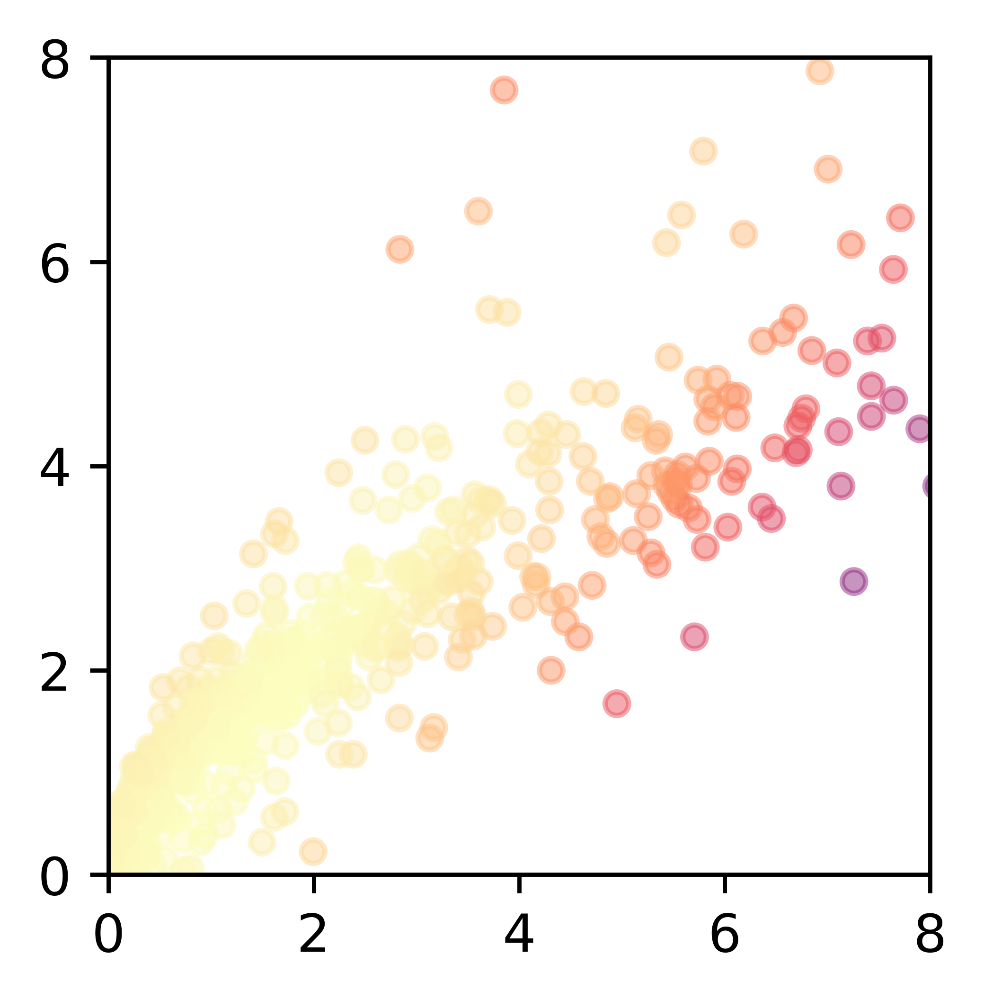

In [63]:
from scipy.stats import gaussian_kde
df_true_sample = pd.DataFrame(generated_expr.mean(axis=0))
df_pred_sample = pd.DataFrame(visium_adata_cropped.X.mean(axis=0))

plt.figure(figsize=(2.8,2.8),dpi=800)
ax = plt.gca()

xx = df_true_sample.T.to_numpy().flatten()
yy = df_pred_sample.T.to_numpy().flatten()


for gene in df_true_sample.columns:
    try:
        gene_true = df_true_sample[gene].values
        gene_pred = df_pred_sample[gene].values
        gexp_stacked = np.vstack([df_true_sample[gene].values, df_pred_sample[gene].values])

        z = gaussian_kde(gexp_stacked)(gexp_stacked)
        ax.scatter(gene_true, gene_pred, c=z, s=20, alpha=0.5,cmap='magma')
    except np.linalg.LinAlgError as e:
        pass
plt.xlim([0,8])
plt.ylim([0,8])

In [70]:
concat_ =anndata.AnnData(np.concatenate([adata_model_gener_reindexed.obsm['generated_expr']],axis=1))
sc.pp.normalize_total(concat_)
sc.pp.log1p(concat_)
sc.pp.pca(concat_)
sc.pp.neighbors(concat_,n_neighbors=100)
sc.tl.umap(concat_,min_dist=1)
sc.tl.leiden(concat_,resolution=2)

adata_model_gener_reindexed.obsm['sc_inte_umap'] = concat_.obsm['X_umap']


In [71]:
adata_model_gener_reindexed.obs['sc_leiden'] =  np.array(concat_.obs['leiden'])

In [72]:
codex_adata_cropped.obs['cell_type'].unique()

array([10,  6,  4,  3,  5, 11,  1,  8,  0,  7,  2,  9, 13])

10
6
4
3
5
11
1
8
0
7
2
9
13


Text(0, 0.5, '')

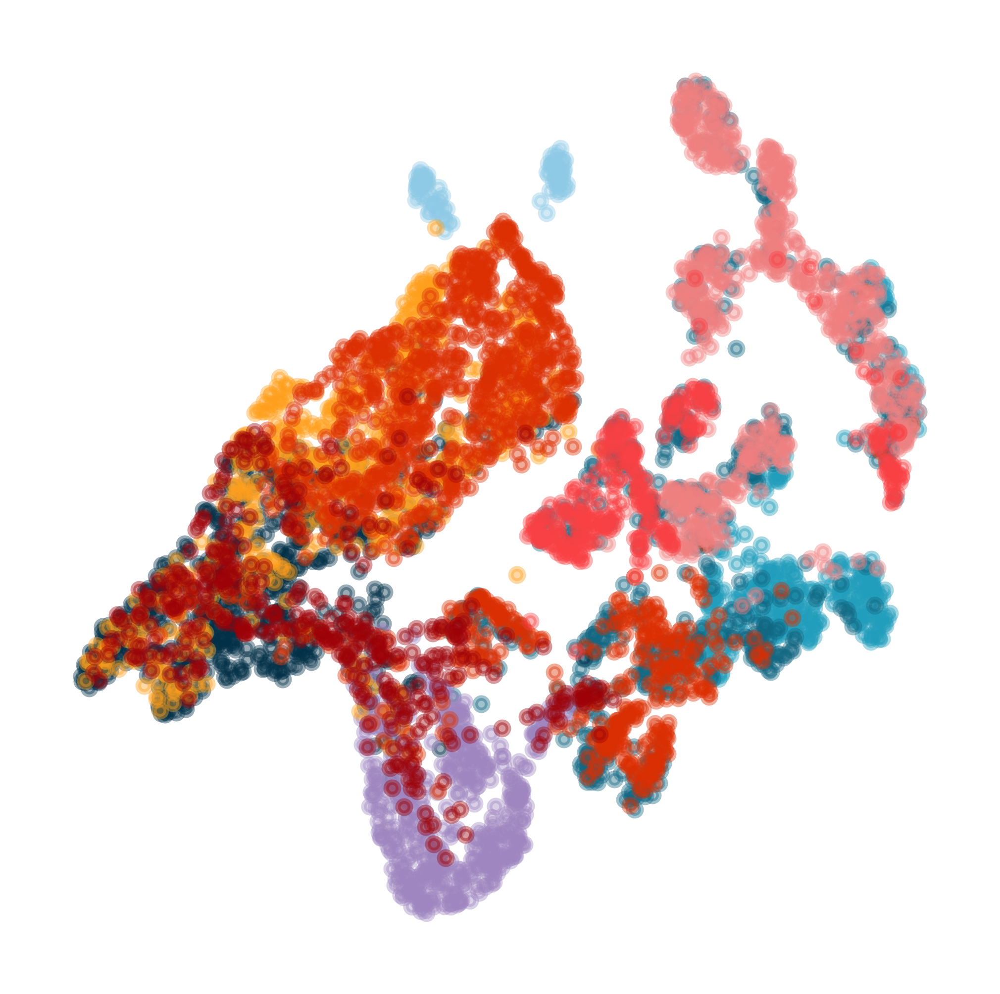

In [73]:
color_list = [
'#8ecae6',
'#219ebc',
'#126782',
'#023047',
'#9f86c0',                                   
'#d4e09b',
    
'#ff9f1c',
'#dc2f02',

'#dc2f02',
'#9d0208',
'#f08080',
'#f94144',
                    '#f3722c',
                    '#f8961e',
                    '#f9c74f',
                    '#90be6d',
                    '#43aa8b',
                    '#577590',  
                    '#226CE0',
                    '#534B62'
]
plt.subplots(1,1,figsize= (3,3),dpi=800)
for j,i in enumerate(codex_adata_cropped.obs['cell_type'].unique()):
    print(i)
    plt.scatter(adata_model_gener_reindexed.obsm['sc_inte_umap'][adata_model_gener_reindexed.obs['leiden']==str(i),0],
                adata_model_gener_reindexed.obsm['sc_inte_umap'][adata_model_gener_reindexed.obs['leiden']==str(i),1],
                s=5,
                alpha = 0.4,
                color = color_list[j]
               )
#plt.legend(adata_model_gener_reindexed.obs['cluster'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.ylabel('')

Text(0, 0.5, '')

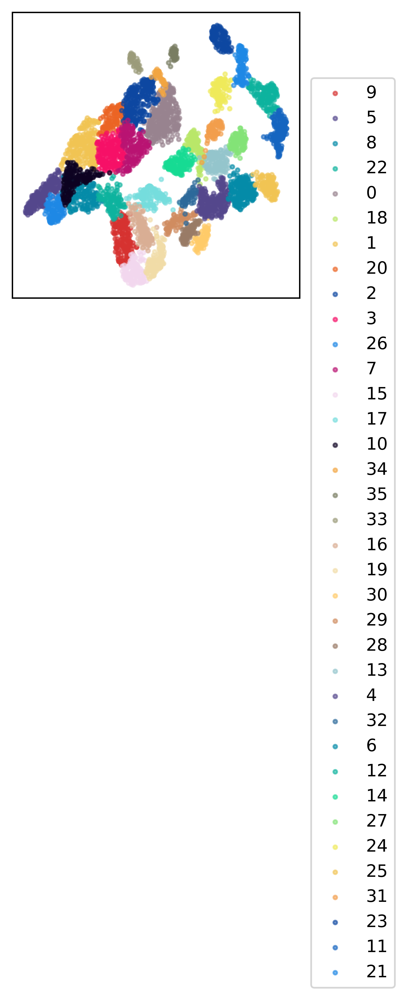

In [74]:

color_list = [
    '#D63230','#54478c', '#048ba8', '#0db39e', '#98838F',

              '#b9e769', 

              '#f1c453', 

              '#EB6424',
              '#0d47a1', 
              '#F61067',
              '#1e88e5',
             '#B91372',
              '#F2D7EE',
              '#75DDDD',
              '#0D0221',
             '#F2A541',
    '#797d62',
                '#9b9b7a',
                '#d9ae94',
                '#f1dca7',
                '#ffcb69',
                '#d08c60',
                '#997b66',
                '#94C5CC',
    
    
    '#54478c', '#2c699a', 
    '#048ba8', '#0db39e', '#16db93',
              '#83e377', 
    '#efea5a', '#f1c453', '#f29e4c',
              '#0d47a1', '#1565c0', '#1e88e5', 
    '#42a5f5', '#90caf9',
              '#bbdefb','#D63230',

              '#b9e769', 

              '#f1c453', 

              '#EB6424',
              '#0d47a1', 
              '#F61067',
              '#1e88e5',
             '#B91372',
              '#F2D7EE',
              '#75DDDD',
              '#0D0221',
             '#F2A541'
             ]
plt.subplots(1,1,figsize= (3,3),dpi=800)
for j,i in enumerate(adata_model_gener_reindexed.obs['sc_leiden'].unique()):
    plt.scatter(adata_model_gener_reindexed.obsm['sc_inte_umap'][adata_model_gener_reindexed.obs['sc_leiden']==i,0],
                adata_model_gener_reindexed.obsm['sc_inte_umap'][adata_model_gener_reindexed.obs['sc_leiden']==i,1],
                s=5,
                alpha = 0.6,
                color = color_list[j]
               )
plt.legend(adata_model_gener_reindexed.obs['sc_leiden'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])
plt.yticks([])
plt.xlabel('')
plt.ylabel('')

0
1
10
11
12
13
14
15
16
17
18
19
2
20
21
22
23
24
25
26
27
28
29
3
30
31
32
33
34
35
4
5
6
7
8
9


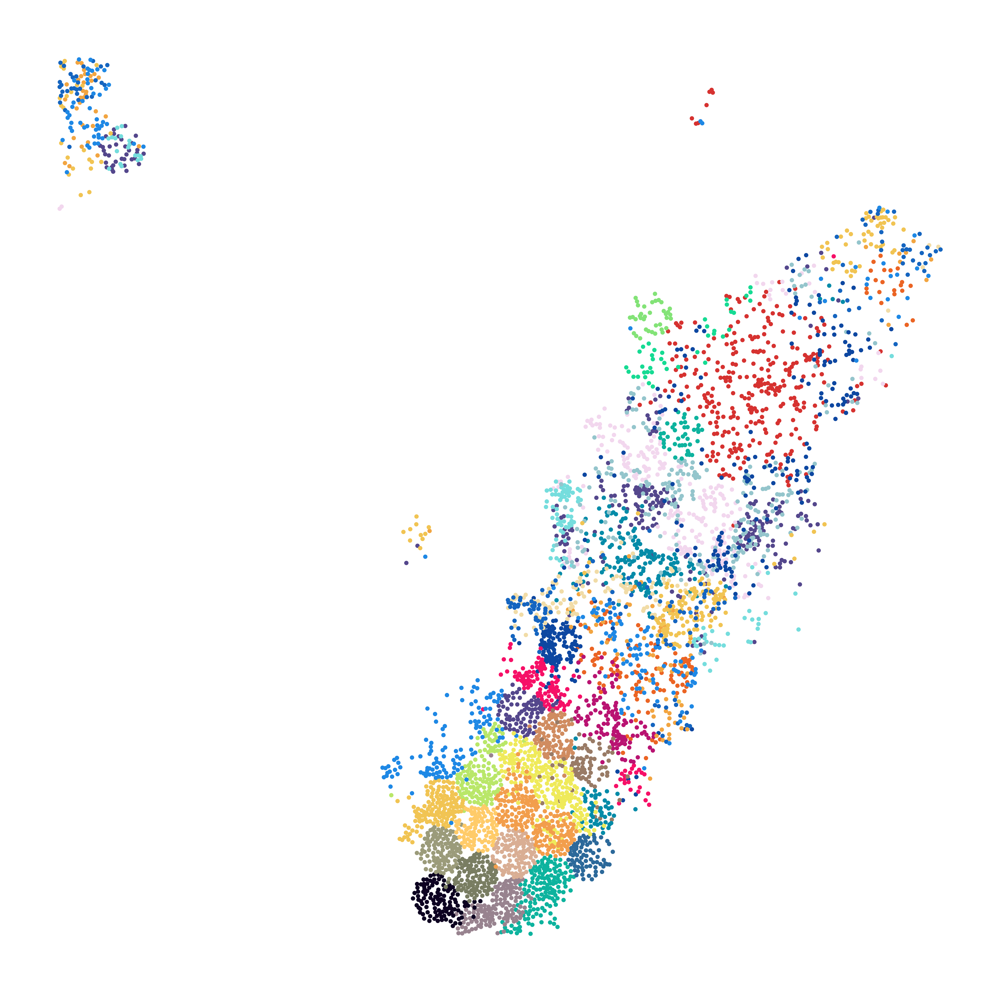

In [75]:
fig, ax = plt.subplots(1,1,figsize=(8,8),dpi=800)
for j,i in enumerate(sorted(adata_model_gener_reindexed.obs['sc_leiden'].unique())):
    print(i)
    plt.scatter(adata_model_gener_reindexed.obsm['spatial'][adata_model_gener_reindexed.obs['sc_leiden']==i,0],
                adata_model_gener_reindexed.obsm['spatial'][adata_model_gener_reindexed.obs['sc_leiden']==i,1],
                s=1,
                color = color_list[j]
               )
#plt.legend(sorted(adata_cluster.obs['cluster'].unique()),bbox_to_anchor=(1.01,0.8))
plt.axis('off') 
plt.gca().invert_yaxis()

In [77]:
visium_adata.to_df().columns[[i.startswith('Cd') for i in visium_adata.to_df().columns]]

NameError: name 'visium_adata' is not defined

In [78]:
generated_expr_adata = anndata.AnnData(adata_model_gener_reindexed.obsm['generated_expr'])
generated_expr_adata.var_names = visium_adata_cropped.var_names
generated_expr_adata.obs_names = codex_adata_cropped.obs_names


In [79]:
generated_expr_adata.var_names

Index(['A4GNT', 'ABCG2', 'ABHD15', 'ABHD18', 'AC004593.3', 'AC011005.1',
       'AC072022.2', 'AC099489.1', 'AC233723.1', 'ACAA1',
       ...
       'ZNF792', 'ZNF823', 'ZNHIT2', 'ZPBP2', 'ZSCAN18', 'ZSCAN25', 'ZSCAN30',
       'ZSWIM2', 'ZSWIM4', 'ZYG11B'],
      dtype='object', length=1046)

Text(0, 0.5, '')

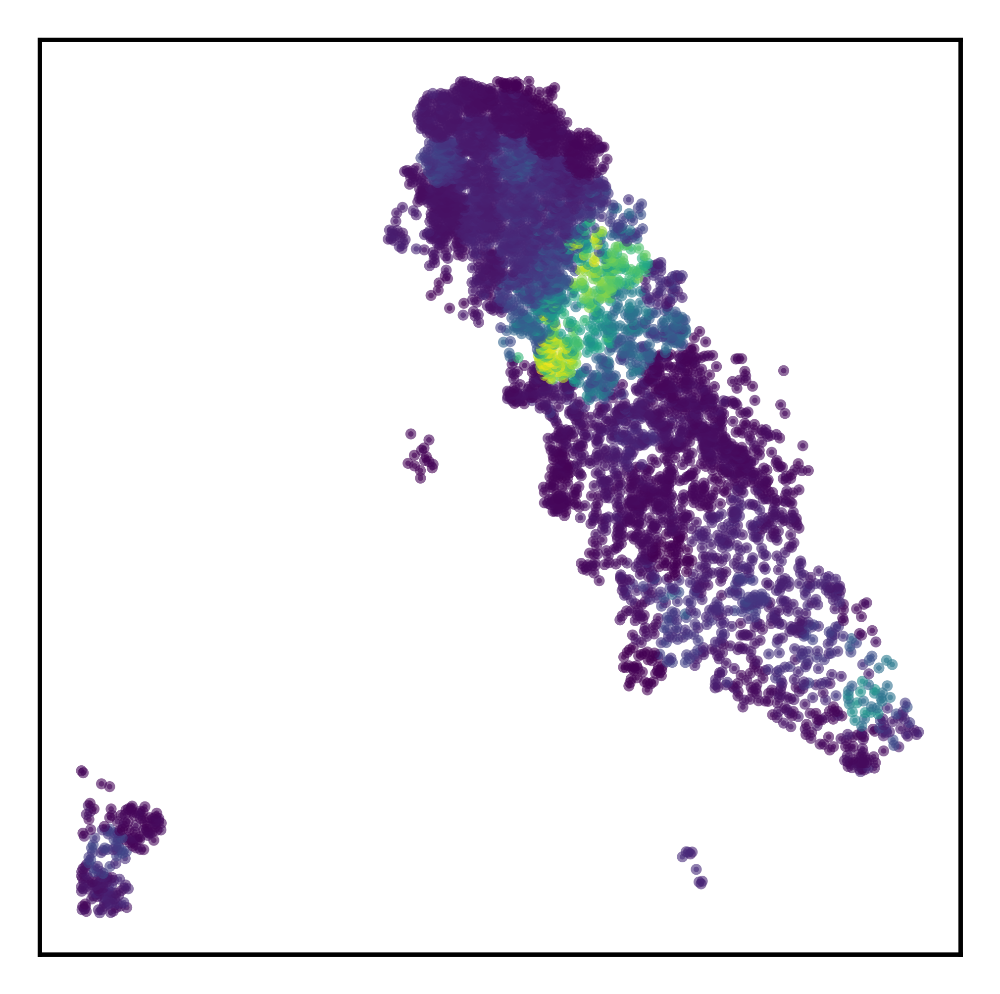

In [80]:
plt.subplots(1,1,figsize= (3,3),dpi=800)
plt.scatter(adata_model_gener_reindexed.obsm['spatial'][:,0],
            adata_model_gener_reindexed.obsm['spatial'][:,1],
                s=1,
                alpha = 0.6,
                c = generated_expr_adata[:,'PECAM1'].to_df().values,
               )
#plt.legend(adata_model_gener_reindexed.obs['sc_leiden'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])
plt.yticks([])
plt.xlabel('')
plt.ylabel('')

Text(0, 0.5, '')

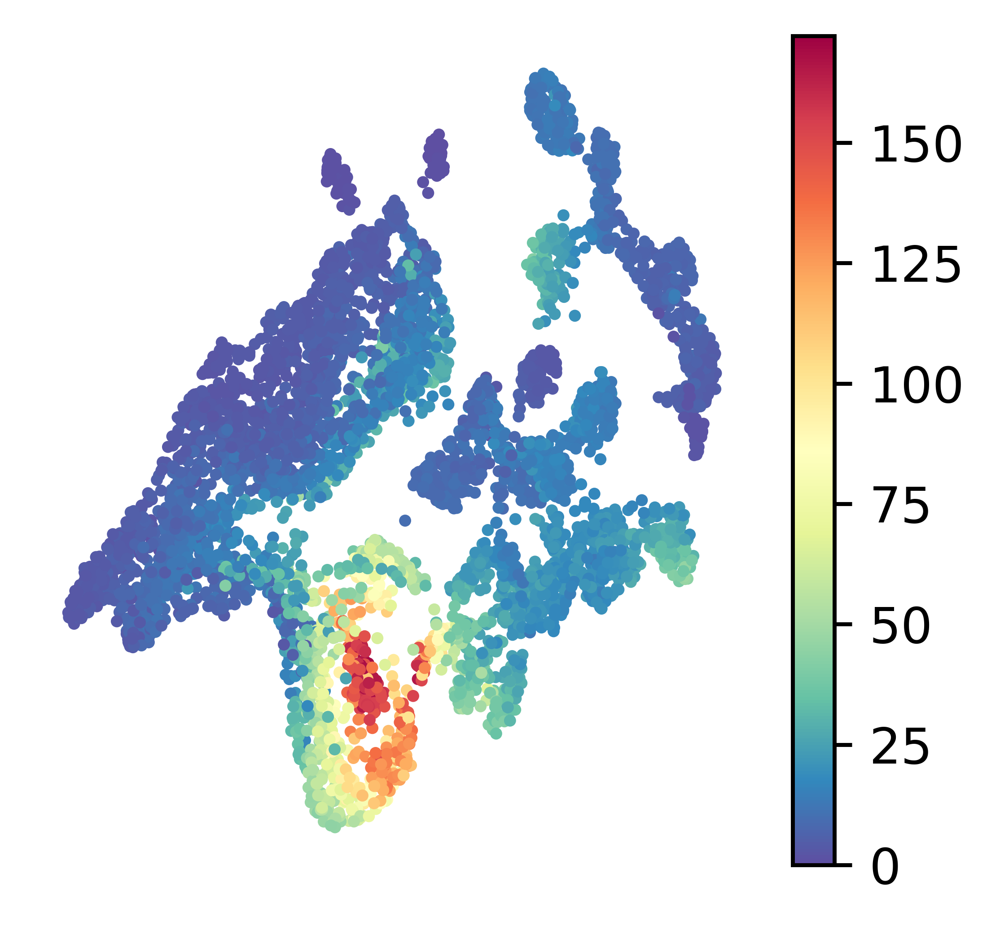

In [81]:
plt.subplots(1,1,figsize= (3.2,3),dpi=800)
g = plt.scatter(adata_model_gener_reindexed.obsm['sc_inte_umap'][:,0],
            adata_model_gener_reindexed.obsm['sc_inte_umap'][:,1],
            s=2,
            alpha = 1,
                cmap='Spectral_r',
            c = generated_expr_adata[:,'PECAM1'].to_df().values,
                vmin=0,
                #vmax=15
           )
plt.colorbar(g)
#plt.legend(adata_model_gener_reindexed.obs['sc_leiden'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])

plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.ylabel('')

Text(0, 0.5, '')

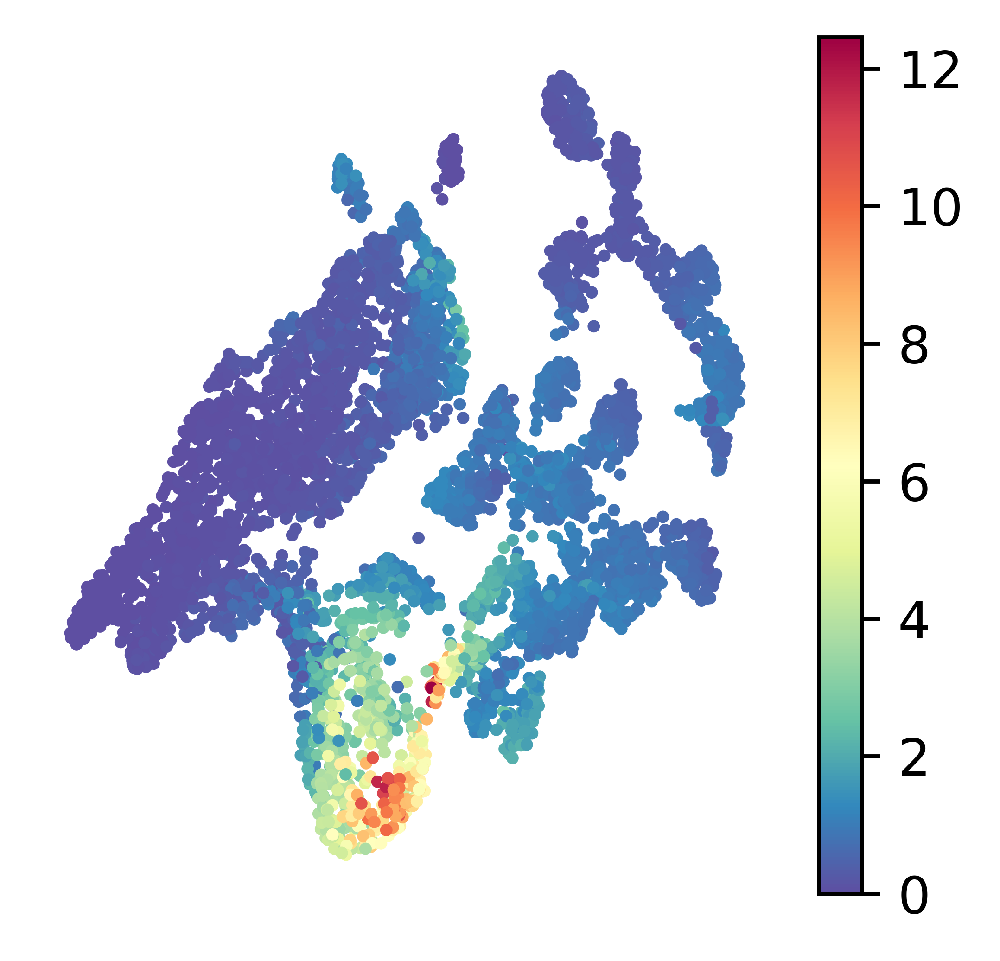

In [82]:
plt.subplots(1,1,figsize= (3.2,3),dpi=800)
g = plt.scatter(adata_model_gener_reindexed.obsm['sc_inte_umap'][:,0],
            adata_model_gener_reindexed.obsm['sc_inte_umap'][:,1],
            s=2,
            alpha = 1,
                cmap='Spectral_r',
            c = generated_expr_adata[:,'CD8A'].to_df().values,
                vmin=0,
                #vmax=15
           )
plt.colorbar(g)
#plt.legend(adata_model_gener_reindexed.obs['sc_leiden'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])

plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.ylabel('')

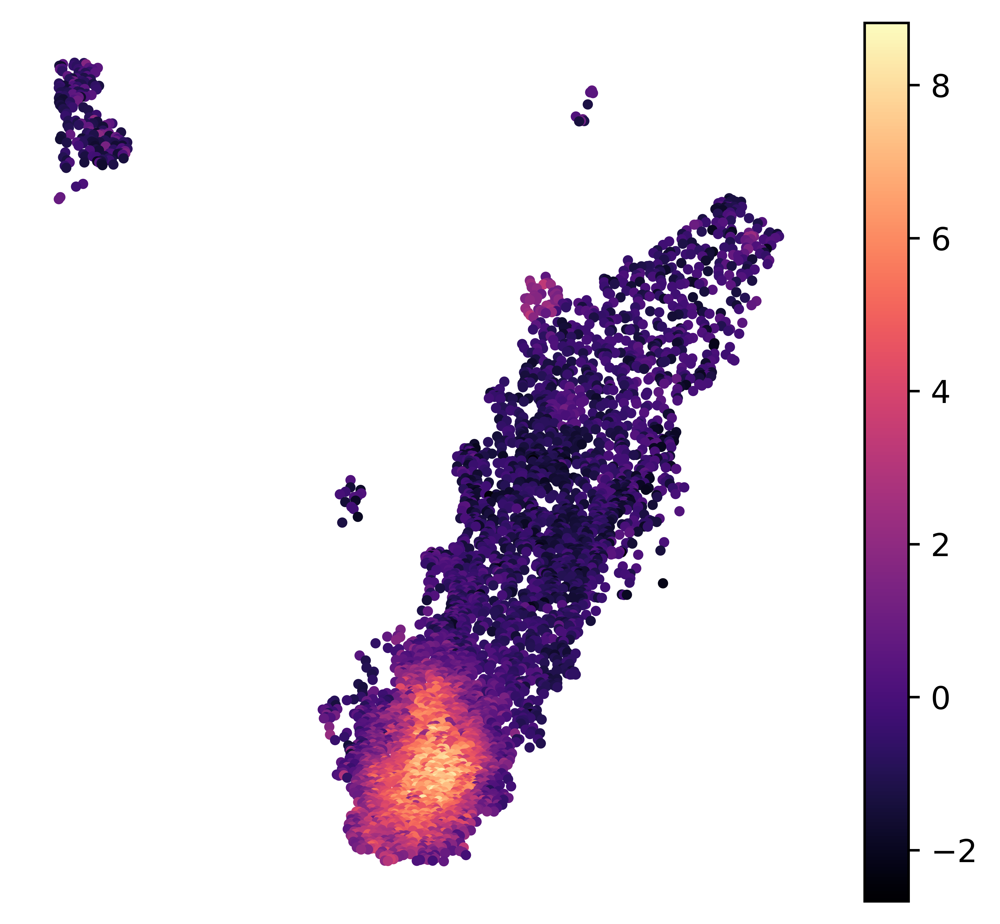

In [83]:
plt.subplots(1,1,figsize= (5.6,5),dpi=800)
g=plt.scatter(adata_model_gener_reindexed.obsm['spatial'][:,0],
            adata_model_gener_reindexed.obsm['spatial'][:,1],
            s=5,
            alpha = 1,
            c = adata_model_gener_reindexed.obsm['v_values'],
            cmap='magma'
           )
plt.colorbar(g)
#plt.legend(adata.obs['annotation'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])
plt.yticks([])
plt.axis('off')
plt.xlabel('')
plt.gca().invert_yaxis()

In [44]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

annotation_column = 'sc_leiden'  # Replace with the actual name of your annotation column

# Step 1: Bin the qv values into equal-width bins
adata_model_gener_reindexed.obs['qv_bin'] = pd.qcut(adata_model_gener_reindexed.obsm['v_values'].flatten(), q=20)  # Adjust q for the number of bins

# Step 2: Calculate the percentage of each annotation in each bin
percentage_df = (
    adata_model_gener_reindexed.obs.groupby(['qv_bin', annotation_column])
    .size()
    .reset_index(name='count')
    .pivot(index='qv_bin', columns=annotation_column, values='count')
)

percentage_df = percentage_df.div(percentage_df.sum(axis=1), axis=0) * 100

color_list = ['#0436bf',
              '#440587',
              '#04bdde',
              '#fc6d00',
              '#cfcd88',
              '#7abd1c',
              '#bf0404',
              '#b2ed4c',
              '#fc5b5b',
              '#5ae89f',
              '#fcd200',
              '#73022f',
              '#d2cbd4',
              '#eeb8ff',
              '#bf02e0',
              '#038c3a'
             ]
color_list = [ '#D63230','#54478c', '#048ba8', '#0db39e', '#98838F',
                  
                  '#b9e769', 
                  
                  '#f1c453', 
                  
                  '#EB6424',
                  '#0d47a1', 
                  '#F61067',
                  '#1e88e5',
                 '#B91372',
                  '#F2D7EE',
                  '#75DDDD',
                  '#0D0221',
                 '#F2A541'
                 ]
color_mapping = {atype: color_list[i] for i, atype in enumerate(codex_adata.obs['type'].unique())}



/tmp/ipykernel_825467/2611499957.py:12: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  adata_model_gener_reindexed.obs.groupby(['qv_bin', annotation_column])


NameError: name 'codex_adata' is not defined

In [ ]:
plt.subplots(1,1,figsize= (3.5,3),dpi=800)
g=plt.scatter(adata_model_gener_reindexed.obsm['sc_inte_umap'][:,0],
            adata_model_gener_reindexed.obsm['sc_inte_umap'][:,1],
            s=10,
            alpha = 0.9,
            c = adata_model_gener_reindexed.obsm['v_values'],
            cmap='magma'
           )
plt.colorbar(g)
#plt.legend(adata.obs['annotation'].unique(),bbox_to_anchor=(1.01,0.8))
plt.xticks([])
plt.yticks([])
plt.xlabel('')